 <font size="6"><b>Рынок заведений общественного питания Москвы</b></font><br />

**Цель проекта** - подготовить исследование рынка Москвы, найти интересные особенности и презентовать полученные результаты, которые в будущем помогут в выборе подходящего инвесторам места. Доступен датасет с заведениями общественного питания Москвы, составленный на основе данных сервисов Яндекс Карты и Яндекс Бизнес на лето 2022 года. Информация, размещённая в сервисе Яндекс Бизнес, могла быть добавлена пользователями или найдена в общедоступных источниках.

Для этого нужно решить следующие **задачи**:
Сделать презентацию информативной и лаконичной. Использовать инструменты визуализации библиотек Python.

Предоставлен датасет `/datasets/moscow_places.csv` со следующими данными:

- *name* — название заведения;
- *address* — адрес заведения;
- *category* — категория заведения, например «кафе», «пиццерия» или «кофейня»;
- *hours* — информация о днях и часах работы;
- *lat* — широта географической точки, в которой находится заведение;
- *lng* — долгота географической точки, в которой находится заведение;
- *rating* — рейтинг заведения по оценкам пользователей в Яндекс Картах (высшая оценка — 5.0);
- *price* — категория цен в заведении, например «средние», «ниже среднего», «выше среднего» и так далее;
- *avg_bill* — строка, которая хранит среднюю стоимость заказа в виде диапазона, например:
    * «Средний счёт: 1000–1500 ₽»;
    * «Цена чашки капучино: 130–220 ₽»;
    * «Цена бокала пива: 400–600 ₽».
    * и так далее;
- *middle_avg_bill* — число с оценкой среднего чека, которое указано только для значений из столбца avg_bill, начинающихся с подстроки «Средний счёт»:
    * Если в строке указан ценовой диапазон из двух значений, в столбец войдёт медиана этих двух значений.
    * Если в строке указано одно число — цена без диапазона, то в столбец войдёт это число.
    * Если значения нет или оно не начинается с подстроки «Средний счёт», то в столбец ничего не войдёт.
- *middle_coffee_cup* — число с оценкой одной чашки капучино, которое указано только для значений из столбца avg_bill, начинающихся с подстроки «Цена одной чашки капучино»:
    * Если в строке указан ценовой диапазон из двух значений, в столбец войдёт медиана этих двух значений.
    * Если в строке указано одно число — цена без диапазона, то в столбец войдёт это число.
    * Если значения нет или оно не начинается с подстроки «Цена одной чашки капучино», то в столбец ничего не войдёт.
- *chain* — число, выраженное 0 или 1, которое показывает, является ли заведение сетевым (для маленьких сетей могут встречаться ошибки):
    * 0 — заведение не является сетевым
    * 1 — заведение является сетевым
- *district* — административный район, в котором находится заведение, например Центральный административный округ;
- *seats* — количество посадочных мест.

**План**

1 Загрузка и подготовка данных к анализу

2 Анализ данных

3 Общий вывод

4 Исследование открытия кофейни

In [1]:
import pandas as pd
import numpy as np
import json
import matplotlib.pyplot as plt
import seaborn as sns
from plotly import graph_objects as go
import matplotlib.patches as mpatches
from folium import Map, Marker, Choropleth
from folium.plugins import MarkerCluster

### Загрузка данных и их подготовка к анализу

In [2]:
data = pd.read_csv('https://code.s3.yandex.net/datasets/moscow_places.csv')

In [3]:
data.head(5)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0


In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


In [5]:
data.duplicated().sum() # поиск дубликатов

0

In [6]:
data.duplicated(subset=['name', 'address']).sum() # поиск неявных дубликатов

0

In [7]:
# поиск неявных дубликатов по названию, категории и адресу
# приведем к нижнему регистру содержимое столбцов в копии среза датасета
df = data[['name', 'category', 'address']].copy()
for col in df.columns:
    try:
        df[col] = df[col].str.lower()
    except AttributeError:
        pass

In [8]:
# поиск неявных дубликатов в столбцах датафрейма
df.duplicated().value_counts()

False    8404
True        2
dtype: int64

In [9]:
# преобразуем во временный датафрейм, чтобы узнать индексы значений True
tmp = df.duplicated()

In [10]:
# индексы дуликатов
tmp.loc[tmp == True].index

Int64Index([215, 1511], dtype='int64')

In [11]:
# удалим строки по индексам в оригинальном датасете
data = data.drop (index=tmp.loc[tmp == True].index)

In [12]:
# поиск неявных дубликатов по категории заведения и его координатам
data.duplicated(subset=['category', 'lat', 'lng']).value_counts()

False    8387
True       17
dtype: int64

In [13]:
# удаление неявных дубликатов
data = data.drop_duplicates(subset=['category', 'lat', 'lng'])

In [14]:
len(data)

8387

In [15]:
data.category.value_counts() # кол-во заведений по категориям

кафе               2368
ресторан           2036
кофейня            1413
бар,паб             765
пиццерия            632
быстрое питание     602
столовая            315
булочная            256
Name: category, dtype: int64

In [16]:
data.district.value_counts() # кол-во заведений по районам

Центральный административный округ         2239
Северный административный округ             895
Южный административный округ                891
Северо-Восточный административный округ     891
Западный административный округ             848
Восточный административный округ            794
Юго-Восточный административный округ        713
Юго-Западный административный округ         707
Северо-Западный административный округ      409
Name: district, dtype: int64

In [17]:
data.isna().sum() # пропущенные значения

name                    0
category                0
address                 0
district                0
hours                 535
lat                     0
lng                     0
rating                  0
price                5074
avg_bill             4574
middle_avg_bill      5241
middle_coffee_cup    7852
chain                   0
seats                3602
dtype: int64

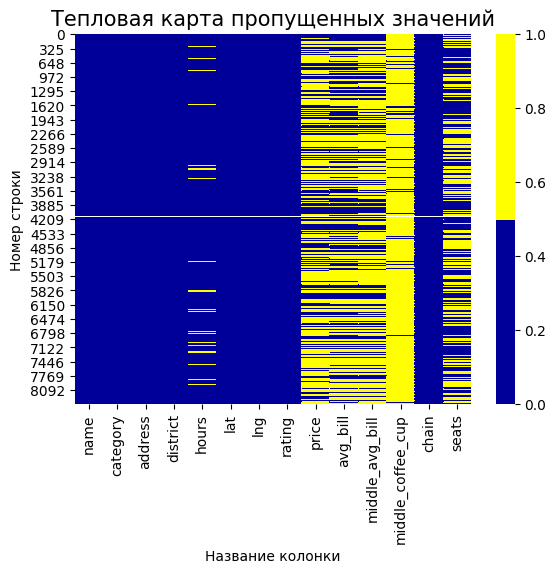

In [18]:
# тепловая карта пропущенных значений 
cols = data.columns
# определяем цвета 
# желтый - пропущенные данные, синий - не пропущенные
colours = ['#000099', '#ffff00'] 
sns.heatmap(data[cols].isnull(), cmap=sns.color_palette(colours), linewidths=.00001)
plt.title('Тепловая карта пропущенных значений', fontsize = 15)
plt.xlabel('Название колонки')
plt.ylabel('Номер строки');

In [19]:
# пропущенные значения
def pass_value_barh(df):
    try:
        (
            (df.isna().mean()*100)
            .to_frame()
            .rename(columns = {0:'space'})
            .query('space > 0')
            .sort_values(by = 'space', ascending = True)
            .plot(kind = 'barh', figsize = (19,6), legend = False, fontsize = 16)
            .set_title('Количество пропусков в столбцах датасета, %' + "\n", fontsize = 22, color = 'SteelBlue')    
        );    
    except:
        print('пропусков нет')

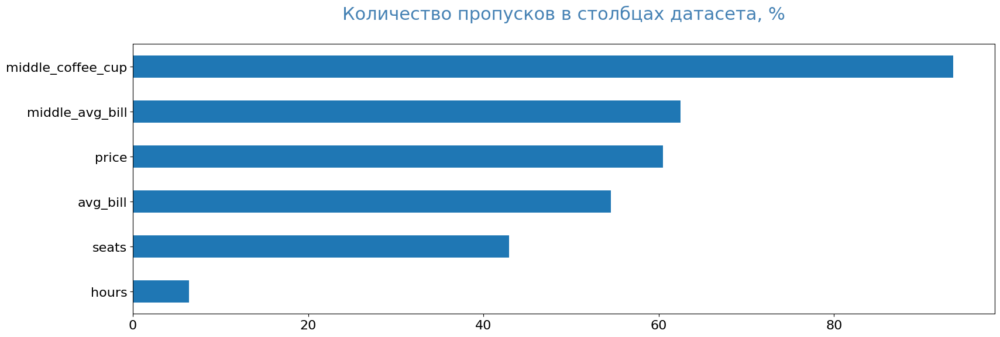

In [20]:
pass_value_barh(data)

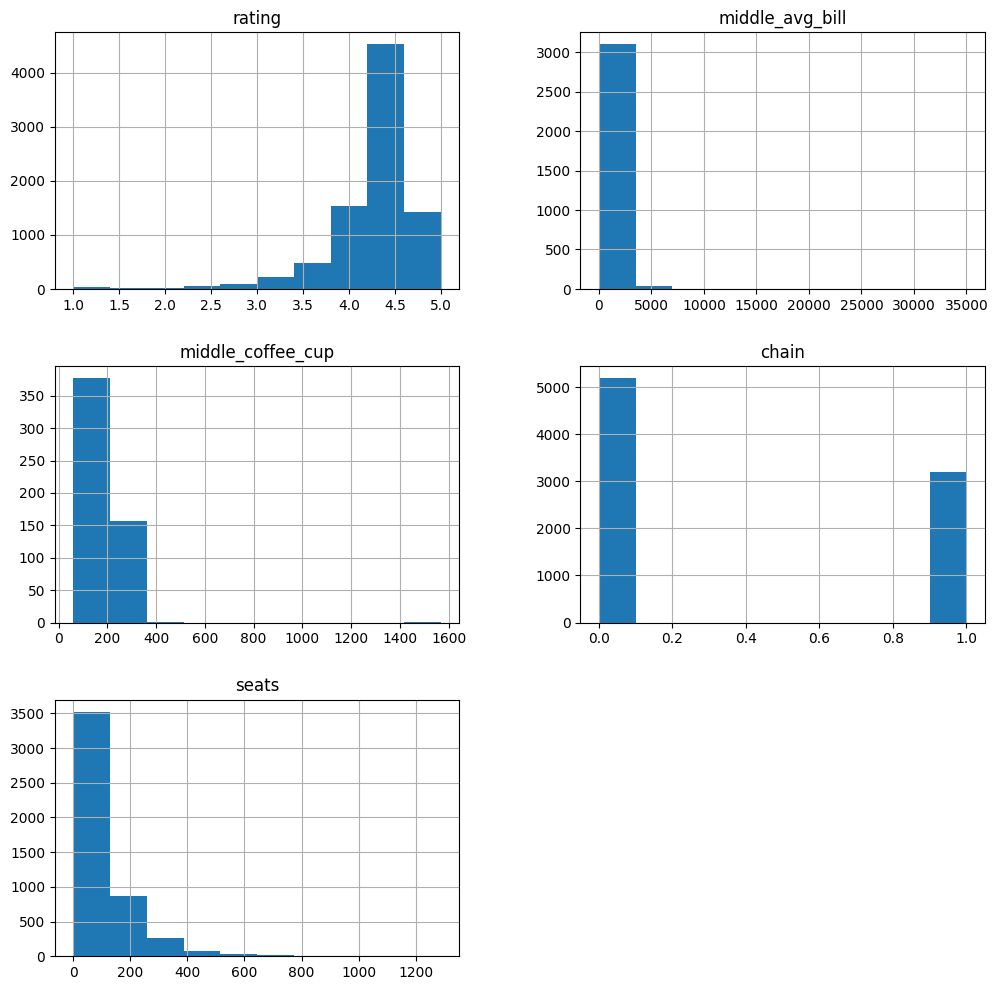

In [21]:
data[['rating', 'middle_avg_bill', 'middle_coffee_cup', 'chain', 'seats']].hist(figsize=(12,12));

**Выводы:**
- основная доля оценок пользователей приходится на 4.5 балла
- средний чек в заведениях составляет примерно 2500 руб
- средний чек за чашку кофе не превышает 250 руб
- обычных заведений на 40% больше, чем сетевых
- посадочных мест в среднем около 125
- Количество записей уменьшилось на 19 строк после поиска неявных дубликатов

#### Добавим столбец `'street'`, вычисленный из столбца `'address'`

In [22]:
data['street'] = data['address'].str.split(pat = ', ').str[1]

In [23]:
data.head(3)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN,улица Дыбенко
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0,улица Дыбенко
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0,Клязьминская улица


#### Добавим столбец `'is_24/7'`, вычисленный из столбца `'hours'`

In [24]:
data['is_24/7'] = np.where(data['hours'] == 'ежедневно, круглосуточно', True, False)
data.head(3)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN,улица Дыбенко,False
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0,улица Дыбенко,False
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0,Клязьминская улица,False


In [25]:
# сброс индексов
data.reset_index(drop= True , inplace= True )

**Вывод:** 
- в датасете представлено 8406 уникальных заведений общественного питания
- в исходных данных нет дубликатов и есть пропуски, которые невозможно заполнить синтетически
- 60% составляют обычные заведения, 40% сетевые
- средний чек составляет 2500 руб, средняя цена чашки кофе не превышает 250 руб, средняя оценка заведения - 4.5 балла
- посадочных мест в среднем около 125
- добавлены 2 столбца: 'street' и 'is_24/7'


### Анализ данных

#### Категории заведений

In [26]:
# сводная таблица количества заведений по каждой категории
type_category = data.pivot_table(index='category', values='name', aggfunc=('count')). \
               sort_values(by='name', ascending=False).reset_index()
type_category 

,category,name
0,кафе,2368
1,ресторан,2036
2,кофейня,1413
3,"бар,паб",765
4,пиццерия,632
5,быстрое питание,602
6,столовая,315
7,булочная,256


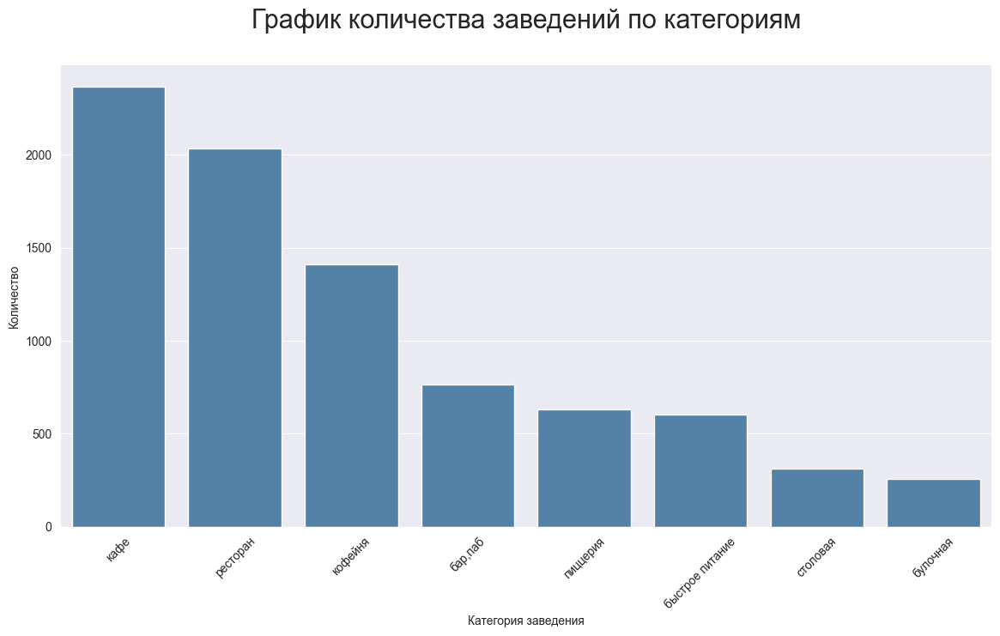

In [27]:
# строим столбчатый график средствами seaborn
plt.figure(figsize=(14, 7))
sns.set_style('dark')
plt.grid()
ax = sns.barplot(x = 'category', y = 'name', color='steelblue', data = type_category.sort_values('name', ascending = False))
plt.title('График количества заведений по категориям' + "\n", fontsize = 22)
plt.xticks(rotation=45)
ax.set(xlabel='Категория заведения')
ax.set(ylabel='Количество')
plt.show()

**Вывод:** Больше всего в городе кафе, ресторанов и кофейн. Столовые и булочные в аутсайдерах.

#### Количество посадочных мест

In [28]:
# сводная таблица по медианым значениям посадочных мест в каждой категории
type_seats = data.pivot_table(index='category', values='seats', aggfunc='median'). \
             sort_values(by='seats', ascending=False).reset_index()
type_seats

,category,seats
0,ресторан,86.0
1,"бар,паб",82.5
2,кофейня,80.0
3,столовая,75.5
4,быстрое питание,67.0
5,кафе,60.0
6,пиццерия,55.0
7,булочная,50.0


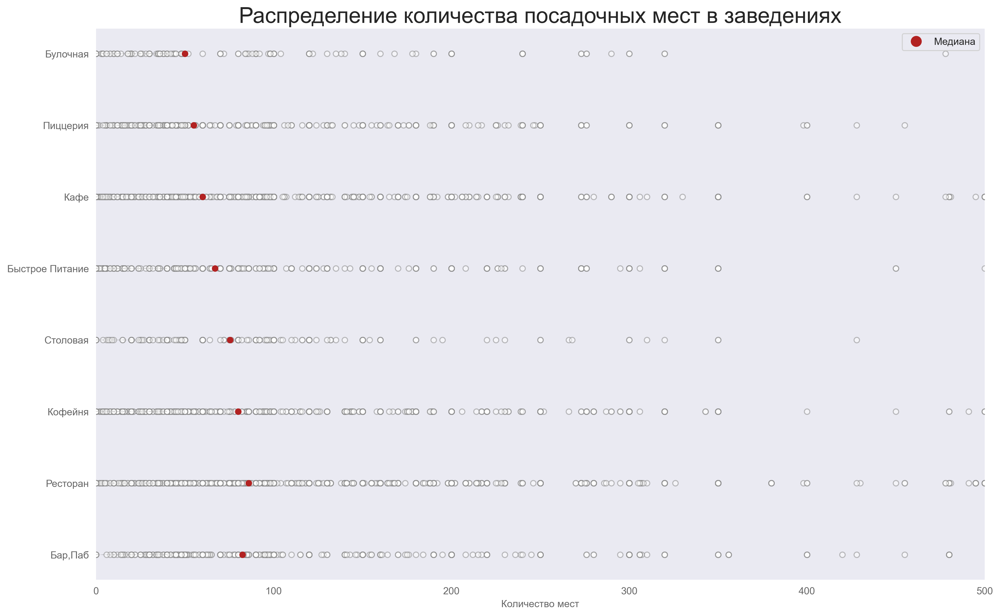

In [29]:
# подготовка данных
df = data[['seats', 'category']].groupby('category').apply(lambda x: x.mean())
df.sort_values('seats', ascending=False, inplace=True)
df.reset_index(inplace=True)
df_median = data[['seats', 'category']].groupby('category').apply(lambda x: x.median())

# Рисуем горизонтальные линии
fig, ax = plt.subplots(figsize=(16,10), dpi=300)
ax.hlines(y=df.index, xmin=0, xmax=40, color='gray', alpha=0.5, linewidth=.5, linestyles='dashdot')

# Рисуем точки
for i, make in enumerate(df.category):
    df_make = data.loc[data.category==make, :]
    ax.scatter(y=[i]*df_make.shape[0], x='seats', data=df_make, s=30, edgecolors='gray', c='w', alpha=0.5)
    ax.scatter(y=i, x='seats', data=df_median.loc[df_median.index==make, :], s=30, c='firebrick')

# Подписи к графику
red_patch = plt.plot([],[], marker="o", ms=10, ls="", mec=None, color='firebrick', label="Медиана")
plt.legend(handles=red_patch)
ax.set_title('Распределение количества посадочных мест в заведениях', fontdict={'size':22})
ax.set_xlabel('Количество мест', alpha=0.7)
ax.set_yticks(df.index)
ax.set_yticklabels(df.category.str.title(), fontdict={'horizontalalignment': 'right'}, alpha=0.7)
ax.set_xlim(0, 500)
plt.xticks(alpha=0.7)
plt.gca().spines["top"].set_visible(False)    
plt.gca().spines["bottom"].set_visible(False)    
plt.gca().spines["right"].set_visible(False)    
plt.gca().spines["left"].set_visible(False)   
plt.grid(axis='both', alpha=.4, linewidth=.1)
plt.show()

**Вывод:** В среднем в городе в ресторанах, барах/пабах и кофейнях больше всего посадочных мест, а меньше всего в пиццериях и булочных.

#### Соотношение сетевых и несетевых заведений

In [30]:
# исправим 0 и 1 на несетевые и сетевые соответсвенно
data['chain_new'] = np.where(data['chain'] == 0, 'несетевые', 'сетевые')
# готовим данные для графика
type_chain = pd.DataFrame(data['chain_new'].value_counts()).reset_index()
type_chain

,index,chain_new
0,несетевые,5187
1,сетевые,3200


In [31]:
# plt.clf()
# строим диаграмму с сегментами
fig = go.Figure(data=[go.Pie(labels=type_chain['index'], # указываем значения, которые появятся на метках сегментов
                             values=type_chain['chain_new'], # указываем данные, которые отобразятся на графике
                             pull = [0.01, 0])]) # добавляем аргумент, который выделит сегмент-лидер на графике
fig.update_layout(title='Соотношение сетевых и несетевых заведений',  # указываем заголовок графика
                  width=800, # указываем размеры графика
                  height=600,
                  annotations=[dict(x=1.1, # вручную настраиваем аннотацию легенды
                                    y=1.05,
                                    text='Тип заведения',
                                    showarrow=False)])

fig.show() # выводим график

**Вывод:** Соотношение несетевых заведений к сетевым в городе примерно 6:4 соответственно.

#### Какие категории заведений чаще являются сетевыми

In [32]:
# сводная таблица количества категорий сетевых заведений
chain_df = data.query('chain == 1').pivot_table(index='category', values='chain', aggfunc='sum').reset_index()
chain_df.sort_values(by='chain', ascending=False)

,category,chain
3,кафе,777
6,ресторан,727
4,кофейня,720
5,пиццерия,330
2,быстрое питание,232
0,"бар,паб",169
1,булочная,157
7,столовая,88


In [33]:
# совместим со сводной таблицей количества заведений по каждой категории
chain_df = chain_df.merge(type_category,how ='left')

In [34]:
chain_df

,category,chain,name
0,"бар,паб",169,765
1,булочная,157,256
2,быстрое питание,232,602
3,кафе,777,2368
4,кофейня,720,1413
5,пиццерия,330,632
6,ресторан,727,2036
7,столовая,88,315


In [35]:
# процент сетевых заведений от общего количетсва каждой категории
chain_df['ratio'] = round(chain_df['chain'] / chain_df['name'] * 100, 1)
chain_df = chain_df.sort_values(by='ratio', ascending=False)
chain_df

,category,chain,name,ratio
1,булочная,157,256,61.3
5,пиццерия,330,632,52.2
4,кофейня,720,1413,51.0
2,быстрое питание,232,602,38.5
6,ресторан,727,2036,35.7
3,кафе,777,2368,32.8
7,столовая,88,315,27.9
0,"бар,паб",169,765,22.1


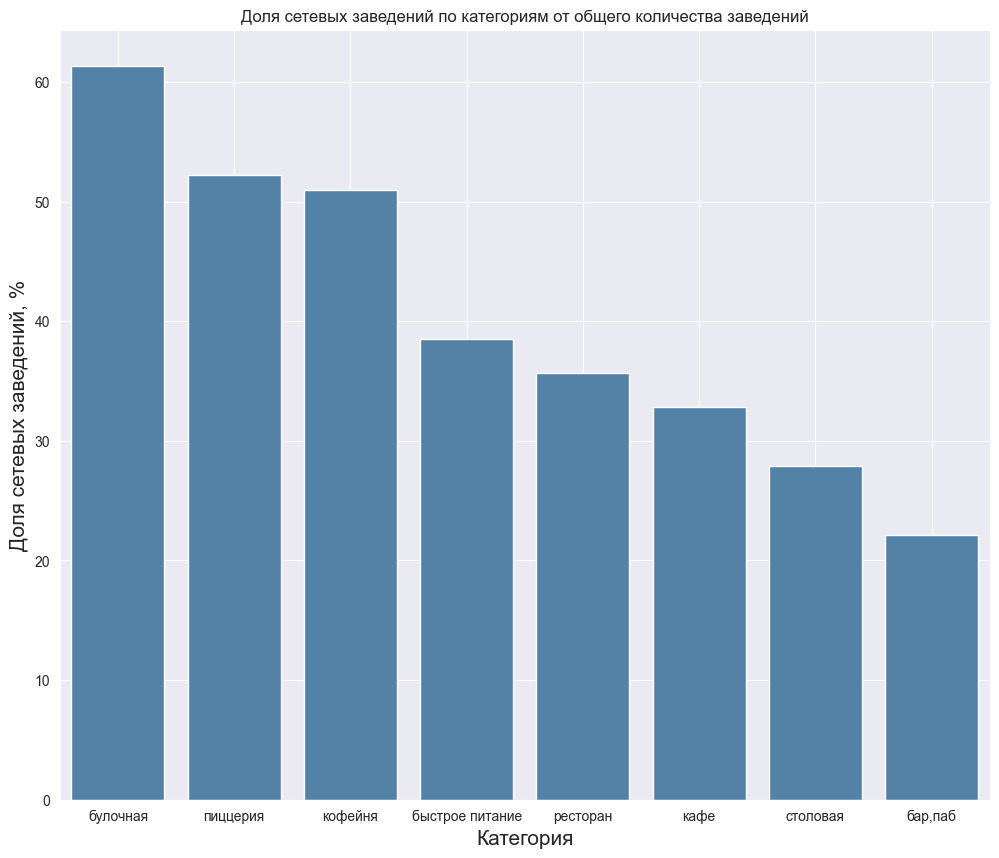

In [36]:
fig, ax = plt.subplots(figsize = (12, 10))
ax = sns.barplot(x = 'category', y = 'ratio', data = chain_df, color='steelblue')
plt.title('Доля сетевых заведений по категориям от общего количества заведений')
ax.set_ylabel('Доля сетевых заведений, %', fontsize=15)
ax.set_xlabel('Категория', fontsize=15)
plt.grid()
plt.show()

**Вывод** Сетевые булочные, пиццерии и кофейни являются фаворитами перед остальными категориями в процентном соотношении количества заведений этих категорий к общему количеству заведений.

<div class="alert alert-info">
<font size="4", color = "black"><b>✍ Комментарий студента</b></font>
    <br /> 
    <font size="3", color = "black">
<br /> Теперь понял задание, переделал его. Действительно так получается наглядней.

#### Соотношение категорий сетевых заведений

In [37]:
# подсчет доли сетевых/несетевых заведений
chain_freq = data.groupby('category')['chain_new'].value_counts(normalize=True).to_frame()
chain_freq.rename(columns={'chain_new': 'perc'}, inplace=True) # переименовываем столбец долей
chain_freq['perc'] = round(chain_freq['perc'] * 100) # переводим доли в проценты
chain_freq = chain_freq.reset_index()
chain_freq

,category,chain_new,perc
0,"бар,паб",несетевые,78.0
1,"бар,паб",сетевые,22.0
2,булочная,сетевые,61.0
3,булочная,несетевые,39.0
4,быстрое питание,несетевые,61.0
5,быстрое питание,сетевые,39.0
6,кафе,несетевые,67.0
7,кафе,сетевые,33.0
8,кофейня,сетевые,51.0
9,кофейня,несетевые,49.0


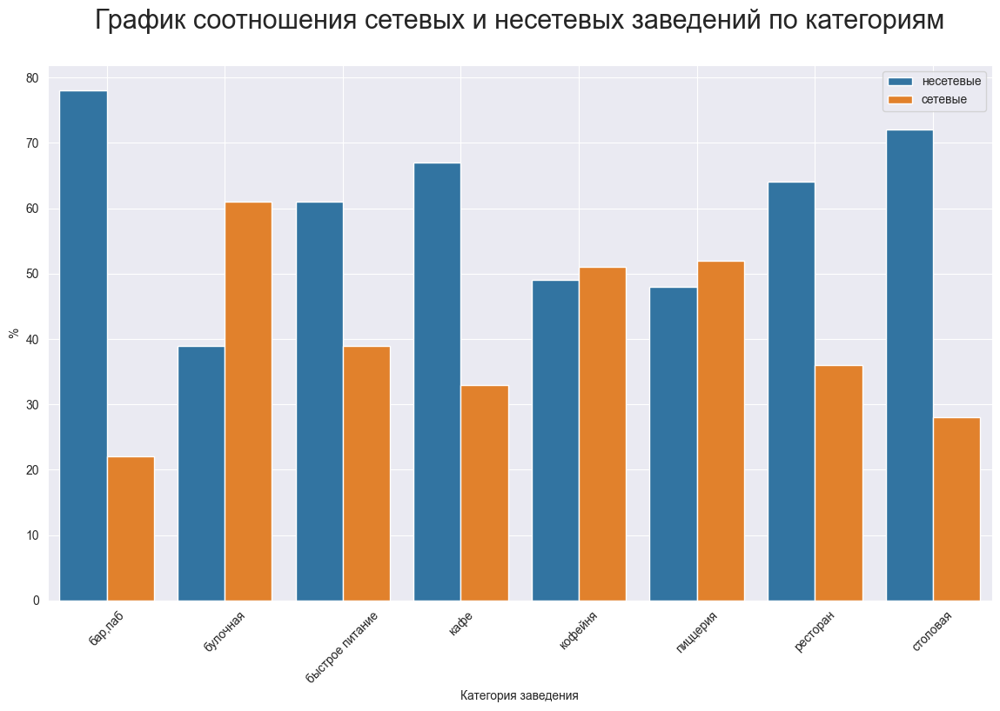

In [38]:
sns.set_style('dark')
# назначаем размер графика
plt.figure(figsize=(14, 8))
# строим столбчатый график средствами seaborn
sns.barplot(x='category', y='perc', data=chain_freq, hue='chain_new')
# формируем заголовок графика и подписи осей средствами matplotlib
plt.title('График соотношения сетевых и несетевых заведений по категориям' + "\n", fontsize = 22)
plt.xlabel('Категория заведения')
plt.ylabel('%')
# поворачиваем подписи значений по оси X на 45 градусов
plt.xticks(rotation=45)
# выбираем положение легенды и указываем размер шрифта
plt.legend(loc='upper right', fontsize=10)
# добавляем сетку
plt.grid()
# отображаем график на экране
plt.show()

**Вывод:** Категорией с самой большой долей сетевых заведений являются булочные - 60%, затем пицерии и кофейни - по 50% каждая. Бары, пабы являются самой "свободной категорией" - всего лишь 20% являются сетевыми.

#### Топ-15 популярных сетей

In [39]:
# сводная таблица количества сетевых заведений
top_15 = data.query('chain == 1').pivot_table(index='name', values='address', aggfunc='count'). \
         sort_values(by='address', ascending=False).head(15)
top_15

,address
name,
Шоколадница,120
Домино'с Пицца,76
Додо Пицца,74
One Price Coffee,71
Яндекс Лавка,69
Cofix,65
Prime,50
Хинкальная,44
КОФЕПОРТ,42


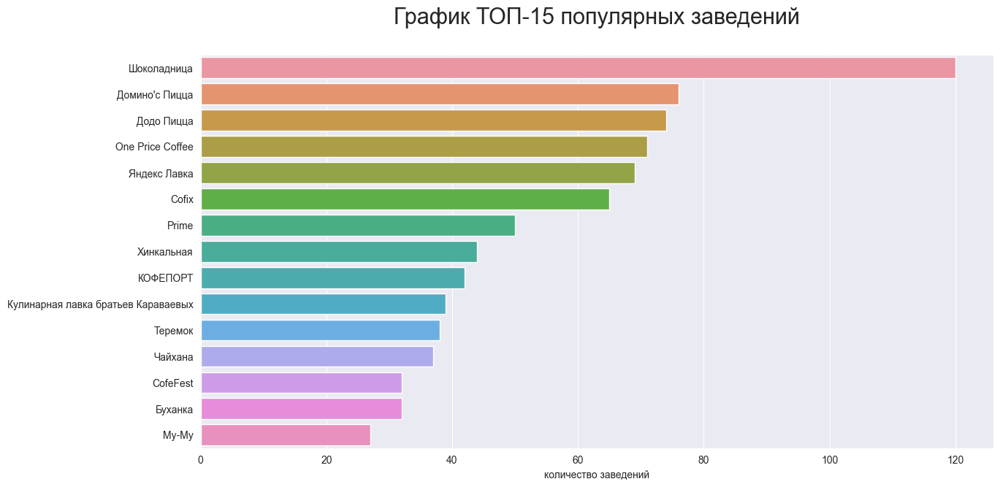

In [40]:
# строим столбчатый график средствами seaborn
plt.figure(figsize=(14, 7))
sns.set_style('dark')
plt.grid()
ax = sns.barplot(x = 'address', y = top_15.index, data = top_15.sort_values('address', ascending = False))
plt.title('График ТОП-15 популярных заведений' + "\n", fontsize = 22)
ax.set(xlabel='количество заведений')
ax.set(ylabel=None)
plt.show()

In [41]:
# список топ-15 заведений
top_list = top_15.index.to_list()
# срез по топ-15 заведениям
data_top = data.query('name in @top_list')
# подсчет категорий заведений по названиям из топ-15 заведений
df_data_top = data_top.groupby(['name','category'])['category'].count().to_frame()
# переименовываем столбец
df_data_top.rename(columns={'category':'count'}, inplace=True)
df_data_top = df_data_top.reset_index().sort_values(by='count', ascending=False)
df_data_top

,name,category,count
31,Шоколадница,кофейня,119
10,Домино'с Пицца,пиццерия,76
9,Додо Пицца,пиццерия,74
3,One Price Coffee,кофейня,71
32,Яндекс Лавка,ресторан,69
2,Cofix,кофейня,65
5,Prime,ресторан,49
11,КОФЕПОРТ,кофейня,42
12,Кулинарная лавка братьев Караваевых,кафе,39
21,Теремок,ресторан,36


Одни и те же заведения могут относится к разным категориям, что будет искажать результат. Это связано с тем, что право выбора категории предоставлено пользователям. Необходимо будет сообщить разработчикам или принять общую концепцию отнесения сетевых заведений к той или иной категории. Произведем дальнейшие вычисления на имеющемся датасете, не внося субъективной оценки разделения на категории.

In [42]:
# пересоберем df для построения графика
df_data_top = df_data_top.groupby(['category'])['count'].sum().to_frame()
df_data_top['ratio'] = round(df_data_top['count'] / df_data_top['count'].sum(),3)
df_data_top = df_data_top.reset_index().sort_values(by='ratio', ascending=False)
df_data_top

,category,count,ratio
4,кофейня,336,0.412
6,ресторан,186,0.228
5,пиццерия,151,0.185
3,кафе,100,0.123
1,булочная,25,0.031
2,быстрое питание,12,0.015
0,"бар,паб",4,0.005
7,столовая,2,0.002


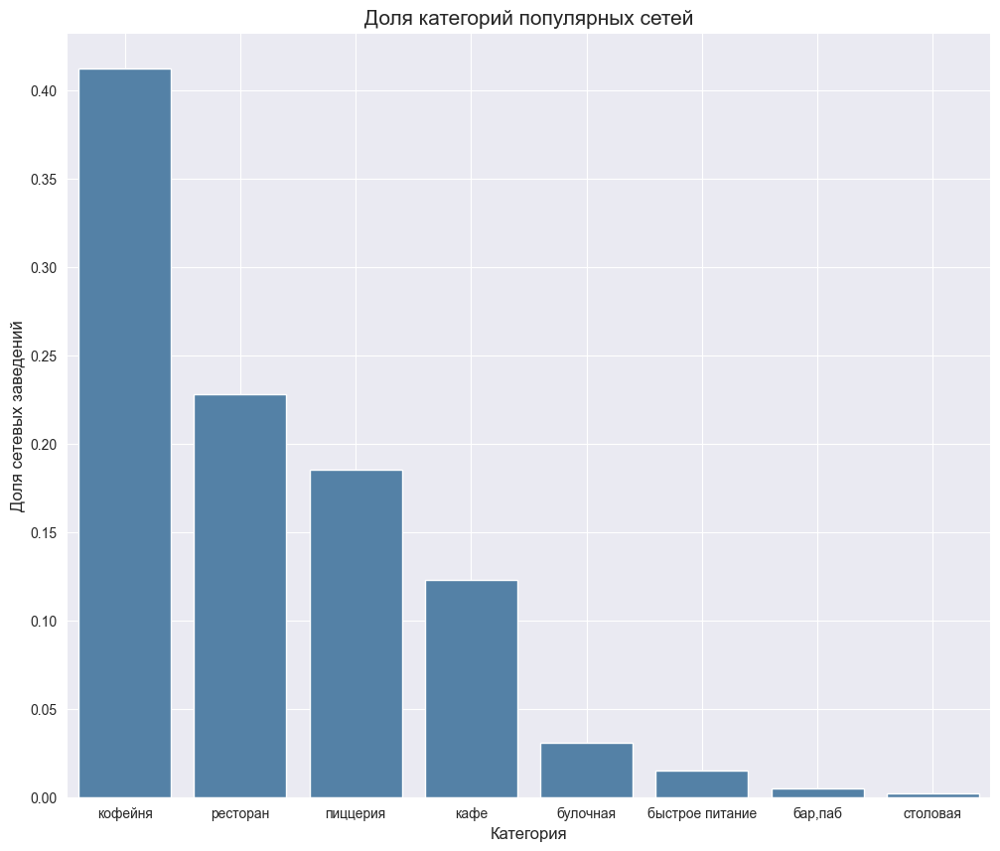

In [43]:
fig, ax = plt.subplots(figsize = (12, 10))
ax = sns.barplot(x = 'category', y = 'ratio', data = df_data_top, color='steelblue')
plt.title('Доля категорий популярных сетей', fontsize=15)
ax.set_ylabel('Доля сетевых заведений', fontsize=12)
ax.set_xlabel('Категория', fontsize=12)
plt.grid()
plt.show()

**Вывод:** сеть заведений "Шоколадница" лидирует в списке популярности посетителей общественного питания. В списке также присутствуют пиццерии и недорогие рестораны. В датасете одни и те же сетевые заведения могут относится к разным категориям, что влияет на его анализ. По исходным данным доля кофеен лидирует в списке популярных сетей.

#### Общее количество заведений и количество заведений каждой категории по районам

In [44]:
# Список районов в датасете
data.district.unique()

array(['Северный административный округ',
       'Северо-Восточный административный округ',
       'Северо-Западный административный округ',
       'Западный административный округ',
       'Центральный административный округ',
       'Восточный административный округ',
       'Юго-Восточный административный округ',
       'Южный административный округ',
       'Юго-Западный административный округ'], dtype=object)

In [45]:
# создадим словарь названий районов для сокращенного отображения
district_renamer = {'Северный административный округ': 'САО', 'Северо-Восточный административный округ': 'СВО',
                    'Северо-Западный административный округ': 'СЗО', 'Западный административный округ': 'ЗАО',
                    'Центральный административный округ': 'ЦАО', 'Восточный административный округ': 'ВАО',
                    'Юго-Восточный административный округ': 'ЮВО', 'Южный административный округ': 'ЮАО',
                    'Юго-Западный административный округ': 'ЮЗАО'
                   }
data['district_new'] = data['district'].map(district_renamer)

In [46]:
# сводная таблица количества категорий заведений по районам
df_area = data.pivot_table(index='district_new', columns='category', values='name', aggfunc='count')
# сумма заведений по категории
df_area['total'] = df_area.sum (axis=1)
df_area

category,"бар,паб",булочная,быстрое питание,кафе,кофейня,пиццерия,ресторан,столовая,total
district_new,,,,,,,,,
ВАО,53,25,71,269,105,72,159,40,794
ЗАО,50,37,61,237,150,71,218,24,848
САО,68,39,58,233,193,77,186,41,895
СВО,63,28,82,269,159,68,182,40,891
СЗО,23,12,30,115,62,40,109,18,409
ЦАО,364,50,87,464,428,112,668,66,2239
ЮАО,68,25,85,264,131,73,201,44,891
ЮВО,38,13,67,281,89,55,145,25,713
ЮЗАО,38,27,61,236,96,64,168,17,707


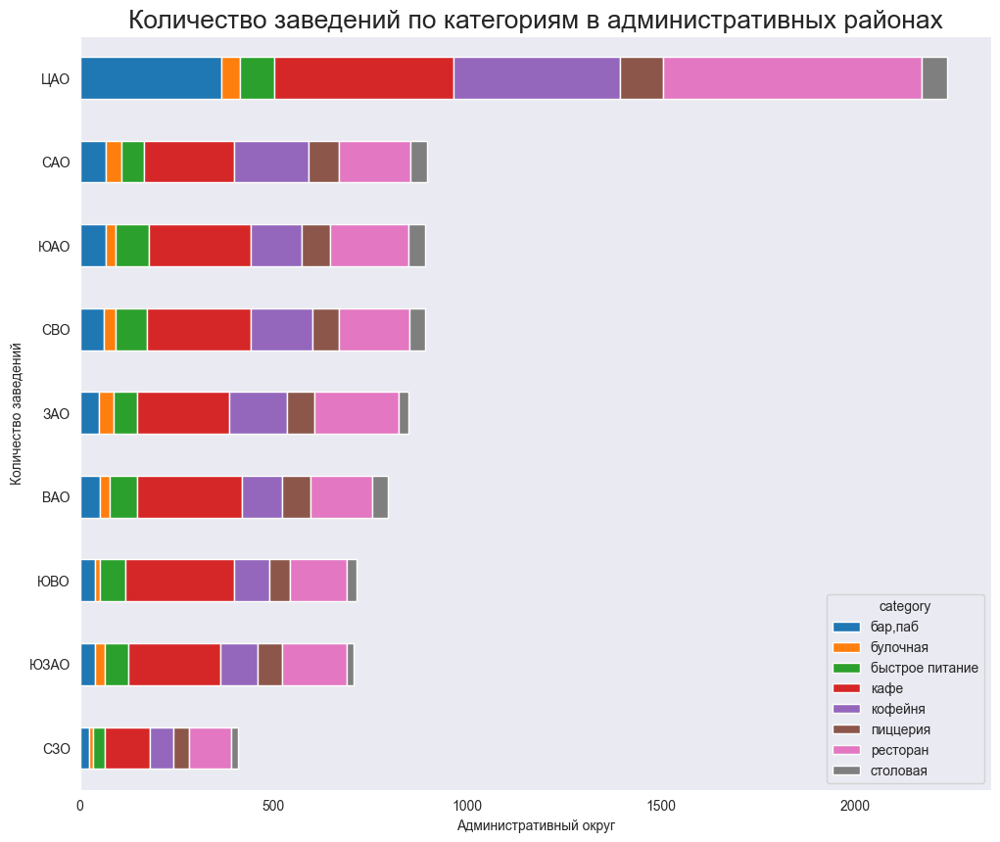

In [47]:
# построение графика с сортировкой колонок графика по кол-ву заведений в каждой категории
df_area.sort_values(by='total').iloc[:,:8].plot(kind='barh', stacked = True,  figsize = (12,10))
plt.xlabel('Административный округ') 
plt.ylabel('Количество заведений') 
plt.title('Количество заведений по категориям в административных районах', fontsize=19) 
plt.show();

**Вывод** Больше всего заведений общепита в Центральном административном округе, меньше всего в Северо-западном округе. Самые распространенные категории во всех округах - кафе, кофейни и рестораны.

#### Распределение средних рейтингов по категориям заведений

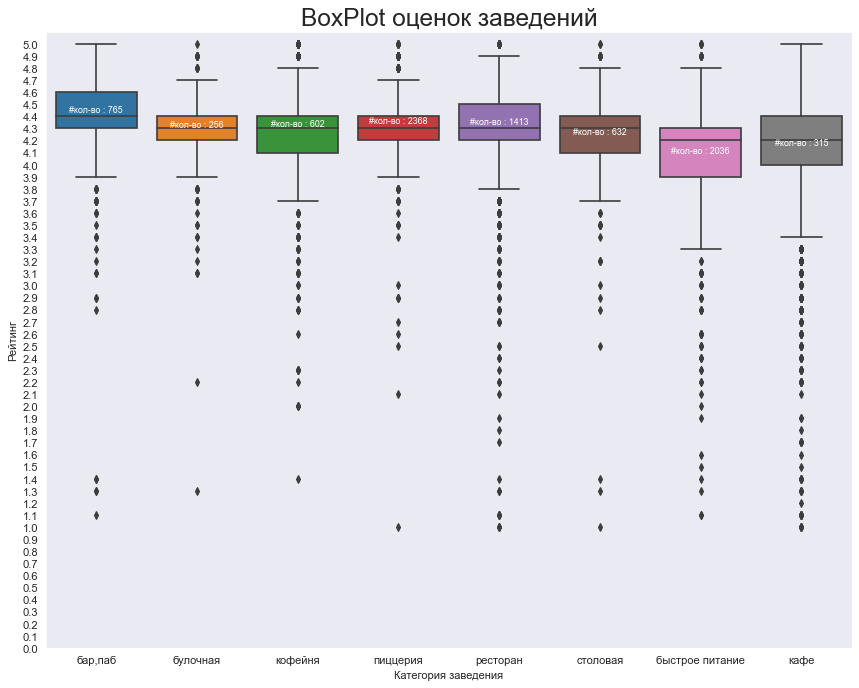

In [48]:
df = data
grouped = df.loc[:,['category', 'rating']].groupby(['category']).median().sort_values(by='rating', ascending=False)

# Рисуем график
plt.figure(figsize=(13,10), dpi= 80)

sns.boxplot(x=df.category, y=df.rating, order=grouped.index, notch=False)


# добавляем метки #кол-во заведений на каждый объект
def add_n_obs(df,group_col,y):
    mean_dict = {grp[0]:grp[1][y].mean() for grp in df.groupby(group_col)}
    xticklabels = [x.get_text() for x in plt.gca().get_xticklabels()]
    n_obs = df.groupby(group_col)[y].size().values
    for (x, xticklabel), n_ob in zip(enumerate(xticklabels), n_obs):
        plt.text(x, mean_dict[xticklabel]*1.01, "#кол-во : "+str(n_ob), horizontalalignment='center', \
                 fontdict={'size':8}, color='white')

add_n_obs(df,group_col='category',y='rating')    

# Подписи к графику
plt.title('BoxPlot оценок заведений', fontsize=22)
plt.xlabel('Категория заведения')
plt.ylabel('Рейтинг')
plt.ylim(0, 5.1)
plt.yticks(np.arange(0,5.1,0.1))
plt.show()

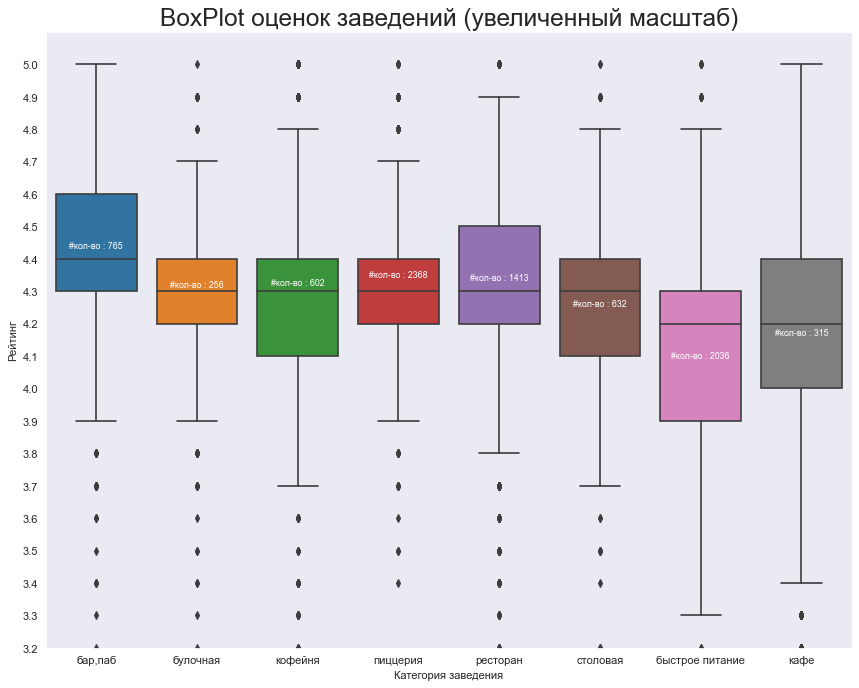

In [49]:
df = data
grouped = df.loc[:,['category', 'rating']].groupby(['category']).median().sort_values(by='rating', ascending=False)

# Рисуем график
plt.figure(figsize=(13,10), dpi= 80)

sns.boxplot(x=df.category, y=df.rating, order=grouped.index, notch=False)


# добавляем метки #кол-во заведений на каждый объект
def add_n_obs(df,group_col,y):
    mean_dict = {grp[0]:grp[1][y].mean() for grp in df.groupby(group_col)}
    xticklabels = [x.get_text() for x in plt.gca().get_xticklabels()]
    n_obs = df.groupby(group_col)[y].size().values
    for (x, xticklabel), n_ob in zip(enumerate(xticklabels), n_obs):
        plt.text(x, mean_dict[xticklabel]*1.01, "#кол-во : "+str(n_ob), horizontalalignment='center', \
                 fontdict={'size':8}, color='white')

add_n_obs(df,group_col='category',y='rating')    

# Подписи к графику
plt.title('BoxPlot оценок заведений (увеличенный масштаб)', fontsize=22)
plt.xlabel('Категория заведения')
plt.ylabel('Рейтинг')
plt.ylim(3.2, 5.1)
plt.yticks(np.arange(3.2,5.1,0.1))
plt.show()

**Вывод** Основная доля средних оценок по каждой категории заведения варьируется от 4.2 до 4.4 баллов, условные лидеры это бары/пабы, у них самый высокий средний балл, и он тяготеет вниз. А самый низкий средний балл 4.2 у заведений быстрого питания, но он тяготеет вверх.

#### Хороплет со средним рейтингом заведений каждого района и отображение всех заведений

In [50]:
# средний рейтинг заведений по каждому району
rating_df = df.groupby('district', as_index=False)['rating'].agg('mean')
rating_df.sort_values(by='rating', ascending=False)

,district,rating
5,Центральный административный округ,4.377535
2,Северный административный округ,4.240894
4,Северо-Западный административный округ,4.208802
8,Южный административный округ,4.185297
1,Западный административный округ,4.182665
0,Восточный административный округ,4.174433
7,Юго-Западный административный округ,4.173126
3,Северо-Восточный административный округ,4.148260
6,Юго-Восточный административный округ,4.101122


In [51]:
# загружаем JSON-файл с границами округов Москвы
try:
    with open(r'/datasets/admin_level_geomap.geojson') as g:
        state_geo = json.load(g)
except:
    state_geo = 'https://code.s3.yandex.net/data-analyst/admin_level_geomap.geojson'

In [52]:
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10, tiles='Cartodb Positron')

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=rating_df,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='Purples',
    fill_opacity=0.8,
    legend_name='Средний рейтинг заведений по районам',
).add_to(m)

# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m)

# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)

# применяем функцию create_clusters() к каждой строке датафрейма
data.apply(create_clusters, axis=1)

# выводим карту
m

####  Топ-15 улиц по количеству заведений

In [53]:
# сводная таблица количества заведений по улицам
top_streets = data.pivot_table(index='street', values='name', aggfunc='count').sort_values(by='name', ascending=False).head(15)
top_streets.rename(columns={'name':'count'}, inplace=True) # переименовываем столбец
top_streets = top_streets.reset_index() # сброс мультииндекса
top_streets

,street,count
0,проспект Мира,184
1,Профсоюзная улица,121
2,проспект Вернадского,106
3,Ленинский проспект,106
4,Ленинградский проспект,95
5,Дмитровское шоссе,88
6,Каширское шоссе,77
7,Варшавское шоссе,76
8,Ленинградское шоссе,70
9,МКАД,65


In [54]:
# список топ-15 улиц
a=top_streets.street.to_list()

In [55]:
# срез топ-15 улиц из исходных данных
data_top_streets = data.query('street == @a')

In [56]:
# подсчет кол-ва категорий заведений на каждой топ-15 улице
streets_cat_cnt = data_top_streets.pivot_table(index='category', columns='street', values='name', aggfunc='count')
streets_cat_cnt

street,Варшавское шоссе,Дмитровское шоссе,Каширское шоссе,Кутузовский проспект,Ленинградский проспект,Ленинградское шоссе,Ленинский проспект,Люблинская улица,МКАД,Профсоюзная улица,Пятницкая улица,проспект Вернадского,проспект Мира,улица Вавилова,улица Миклухо-Маклая
category,,,,,,,,,,,,,,,
"бар,паб",6.0,6.0,2.0,2.0,15.0,5.0,10.0,5.0,1.0,6.0,9.0,7.0,12.0,2.0,3.0
булочная,NaN,2.0,NaN,1.0,4.0,2.0,3.0,NaN,NaN,4.0,3.0,1.0,4.0,2.0,NaN
быстрое питание,7.0,10.0,10.0,2.0,2.0,5.0,2.0,5.0,9.0,15.0,2.0,12.0,21.0,11.0,4.0
кафе,18.0,23.0,20.0,14.0,12.0,13.0,25.0,26.0,45.0,34.0,7.0,23.0,53.0,15.0,21.0
кофейня,14.0,11.0,16.0,13.0,25.0,13.0,23.0,11.0,4.0,18.0,6.0,16.0,36.0,10.0,4.0
пиццерия,4.0,8.0,5.0,3.0,9.0,3.0,5.0,1.0,NaN,15.0,3.0,12.0,11.0,3.0,2.0
ресторан,20.0,24.0,19.0,16.0,25.0,26.0,33.0,10.0,5.0,26.0,18.0,33.0,45.0,12.0,15.0
столовая,7.0,4.0,5.0,3.0,3.0,3.0,5.0,2.0,1.0,3.0,NaN,2.0,2.0,NaN,NaN


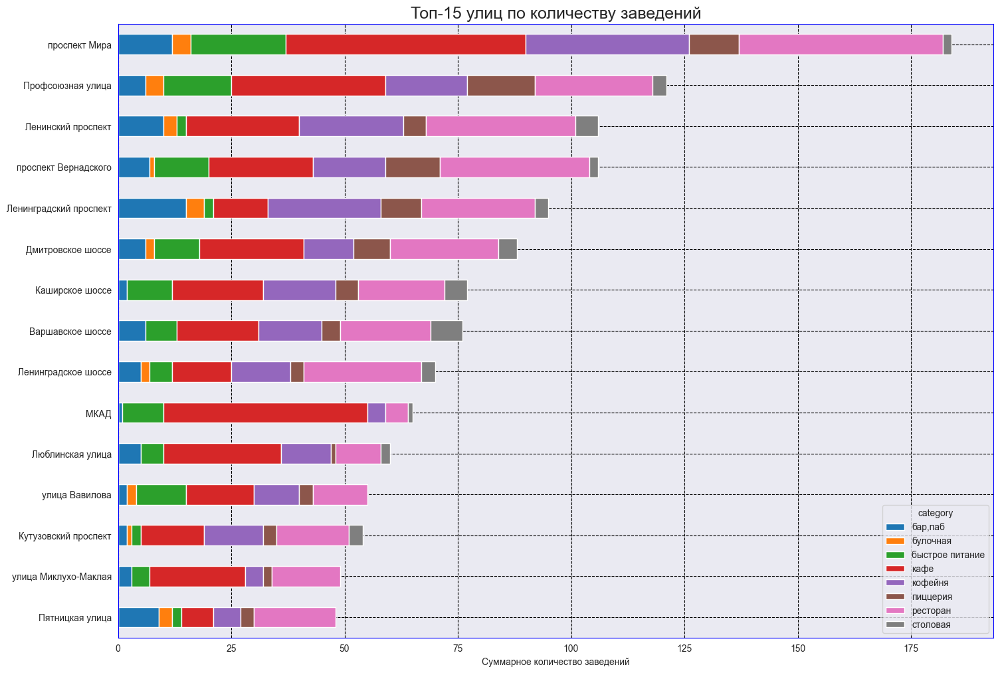

In [57]:
# построение графика
custom = {"axes.edgecolor": "blue", "grid.linestyle": "dashed", "grid.color": "black"}
sns.set_style("darkgrid", rc=custom)
top_streets = top_streets.sort_values(by='count', ascending=True)
streets_cat_cnt[top_streets.street].T.plot.barh(stacked = True, figsize = (17,12))
plt.title('Топ-15 улиц по количеству заведений', fontsize=18)
plt.xlabel('Суммарное количество заведений') 
plt.ylabel(None)
plt.show()

**Вывод:** Больше всего заведений общепита на центральных улицах города и МКАД. По соотношению категорий из графика видно, что доминируют кафе, кофейни, рестораны. Меньше всего или полностью отсутствуют столовые и булочные.

#### Улицы с единственным общепитом

In [58]:
# сводная таблица количетсва заведений по улицам
sz_streets = data.pivot_table(index='street', values='name', aggfunc='count').sort_values(by='name')
sz_streets.rename(columns={'name':'count'}, inplace=True) # переименовываем столбец
sz_streets = sz_streets.reset_index() # сброс мультииндекса

In [59]:
# список улиц с 1 заведением
b = sz_streets.loc[(sz_streets['count'] == 1), 'street'].to_list()
# срез улиц с 1 заведением из исходных данных
data_sz_streets = data.query('street.isin(@b)')

Согласно центральной предельной теореме, средние значения выборок для любой совокупности будут распределены относительно ее среднего значения примерно по нормальному закону. То есть распредение заведений по какому-либо признаку (одно заведение на улице) будет стремится к распределению всей совокупности данных.
Проверим это на примере среднего рейтинга и среднего чека заведений.

In [60]:
# медианный рейтинг заведений по каждому району
rating_df = data_sz_streets.groupby('district', as_index=False)['rating'].agg('median')
rating_df.sort_values(by='rating', ascending=False)

,district,rating
5,Центральный административный округ,4.40
0,Восточный административный округ,4.30
4,Северо-Западный административный округ,4.30
6,Юго-Восточный административный округ,4.30
2,Северный административный округ,4.25
1,Западный административный округ,4.20
3,Северо-Восточный административный округ,4.20
8,Южный административный округ,4.20
7,Юго-Западный административный округ,4.10


In [61]:
data.rating.describe()

count    8387.000000
mean        4.230285
std         0.470320
min         1.000000
25%         4.100000
50%         4.300000
75%         4.400000
max         5.000000
Name: rating, dtype: float64

In [62]:
data_sz_streets.rating.describe()

count    460.000000
mean       4.236087
std        0.461033
min        1.000000
25%        4.100000
50%        4.300000
75%        4.500000
max        5.000000
Name: rating, dtype: float64

Средние значения совпадают, а по стандартному отклонению двух выборок видно, что они однородны.

Для проверки о равенстве средних чеков двух групп сформулируем гипотезу, которая проверяет средние двух совокупностей на равенство методом st.ttest_ind.

Проверяем двусторонюю альтернативную гипотезу - средние значения двух групп не равны, т.е. не важно больше или меньше.

**Нулевая гипотеза:** средние чеки из двух групп равны.

**Альтернативная гипотеза:** средние чеки первой группы не равны средним оценкам второй группы.

In [63]:
# средние чеки первой группы
first_group_scores = data[~data[['middle_avg_bill']].isnull().any(axis=1)].query('street not in (@b)')['middle_avg_bill']
# средние чеки второй группы
second_group_scores = data_sz_streets[~data_sz_streets[['middle_avg_bill']].isnull().any(axis=1)]['middle_avg_bill']

In [64]:
# проверка на равенство двух выборок
if len(first_group_scores) == len(second_group_scores):
    print('выборки равны, используем equal_var = True')
else:
    print('выборки не равны, используем equal_var = False') 

выборки не равны, используем equal_var = False


In [65]:
import scipy.stats as st
alpha = 0.05 # уровень статистической значимости
# если p-value окажется меньше него, отвергнем гипотезу

results = st.ttest_ind(first_group_scores, second_group_scores, equal_var=False)

print('p-значение:', results.pvalue)

if results.pvalue < alpha:
    print('Отвергаем нулевую гипотезу')
else:
    print('Не получилось отвергнуть нулевую гипотезу')

p-значение: 0.9837428379423517
Не получилось отвергнуть нулевую гипотезу


Вывод. На уровне значимости 0,05 принимаем гипотезу, что средние чеки равны между двумя группами.

**Вывод** Заведения с одним общепитом на улице ничем не отличаются от заведений с множеством заведений общепита на одной улице.

#### Анализ среднего чека заведений общественного питания

In [66]:
# медианный чек по районам
df_bill = data[~data[['middle_avg_bill']].isnull().any(axis=1)].groupby('district')['middle_avg_bill'].median().to_frame()
df_bill = df_bill.reset_index().sort_values(by='middle_avg_bill', ascending=False)
df_bill

,district,middle_avg_bill
1,Западный административный округ,1000.0
5,Центральный административный округ,1000.0
4,Северо-Западный административный округ,700.0
2,Северный административный округ,650.0
7,Юго-Западный административный округ,600.0
0,Восточный административный округ,575.0
3,Северо-Восточный административный округ,500.0
8,Южный административный округ,500.0
6,Юго-Восточный административный округ,450.0


In [67]:
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m1 = Map(location=[moscow_lat, moscow_lng], zoom_start=10, tiles='Cartodb Positron')

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=df_bill,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='Reds',
    fill_opacity=0.8,
    legend_name='Медианный чек заведений по районам',
).add_to(m1)

# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m1)

# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['middle_avg_bill']}",
    ).add_to(marker_cluster)

# применяем функцию create_clusters() к каждой строке датафрейма
data.apply(create_clusters, axis=1)

# выводим карту
m1

**Вывод** самые высокие средние чеки в ЦАО и ЗАО, эти районы считаются наиболее престижными в Москве. Самые низкие в ЮВАО.

Чтобы понять как изменяется средний чек от центра к окраинам снова расположим на карте заведения со средним чеком, но исключим из датасета заведения с "пустым" чеком и сетевые заведения, так как цены в них одинаковые в разных частях города.

In [68]:
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m1 = Map(location=[moscow_lat, moscow_lng], zoom_start=10, tiles='Cartodb Positron')

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=df_bill,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='Reds',
    fill_opacity=0.8,
    legend_name='Медианный чек заведений по районам',
).add_to(m1)

# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m1)

# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['middle_avg_bill']}",
    ).add_to(marker_cluster)

# применяем функцию create_clusters() к каждой строке датафрейма
data[~data[['middle_avg_bill']].isnull().any(axis=1)].query('chain == 0').apply(create_clusters, axis=1)

# выводим карту
m1

**Вывод** При случайном выборе в наведении курсора мыши на маркер заведения чеки с более высокой ценой в центре города будут попадатся гораздо чаще, чем на окраине. И наоброт - случайные наведения курсора мыши на заведения на окраинах города будут чаще отображать более низкий средний чек, чем в центре.

### Общий вывод

Проведенный анализ датасета с информацией о заведениях питания г. Москвы показал следующее:

- основная доля из 8406 заведений приходится на кафе и кофейни, которые суммарно составляют половину от остальных. Меньше всего булочных

- максимальное среднее количество посадочных мест в ресторанах, барах/пабах, кофейнях - 84. В пиццериях и булочных - 53

- соотношение несетевых заведений к сетевым составляет 6:4 соответсвенно

- чаще всего сетевыми заведениями являются булочные, кофейни и пиццерии. А по долям в категориальном выражении в этом сегменте лидируют кафе, рестораны и кофейни.

- явный лидер среди сетевых заведений - Шоколадница, аутсайдер - Му-му

- наибольшая концентрация мест общепита - ЦАО, в котором их количество превышает больше чем в 2 раза по сравнению с любым другим районом города. Популярность категорий во всех округах сохраняется: кафе, кофейни и рестораны.

- основная доля средних оценок по каждой категории заведения варьируется от 4.2 до 4.4 баллов, условные лидеры это бары/пабы, у них самый высокий средний балл 4.4, и он тяготеет вниз. А самый низкий средний балл 4.2 у заведений быстрого питания, но он тяготеет вверх

- ТОП-3 улиц с наибольшим совокупным количеством ресторанов, кафе и кофейн - проспект Мира, Профсоюзная улица, проспект Вернадского

- заведения с единственным местом питания на одной улице ничем не отличаются от других с множеством заведений на одной улице

- самые высокие средние чеки можно получить ЦАО и ЗАО, а самые низкие в ЮВАО.

### Исследование открытия кофейни

#### Общее количетсво кофеен в Москве

In [69]:
print(f"Количество кофеен в Москве:", data[data['category'] == 'кофейня']['name'].count())

Количество кофеен в Москве: 1413


In [70]:
cafe_district = data[data['category'] == 'кофейня'].groupby('district')['name'].count().to_frame()
cafe_district = cafe_district.rename(columns={'name': 'count'}).reset_index()
print(f"Количество кофеен по округам:", '\n', cafe_district.sort_values(by='count', ascending=False))

Количество кофеен по округам: 
                                   district  count
5       Центральный административный округ    428
2          Северный административный округ    193
3  Северо-Восточный административный округ    159
1          Западный административный округ    150
8             Южный административный округ    131
0         Восточный административный округ    105
7      Юго-Западный административный округ     96
6     Юго-Восточный административный округ     89
4   Северо-Западный административный округ     62


#### Круглосуточные кофейни

In [71]:
print(f"Количество круглосуточных кофеен в Москве:", data[(data['category'] == 'кофейня') & (data['is_24/7'] == True)] \
      ['name'].count())

Количество круглосуточных кофеен в Москве: 59


In [72]:
print(f"Количество круглосуточных кофеен по округам:", '\n', data[(data['category'] == 'кофейня') & (data['is_24/7'] == True)].\
      groupby('district')['name'].count())

Количество круглосуточных кофеен по округам: 
 district
Восточный административный округ            5
Западный административный округ             9
Северный административный округ             5
Северо-Восточный административный округ     3
Северо-Западный административный округ      2
Центральный административный округ         26
Юго-Восточный административный округ        1
Юго-Западный административный округ         7
Южный административный округ                1
Name: name, dtype: int64


#### Средние рейтинги кофеен и их распределение по районам

In [73]:
print(f"Средний рейтинг кофеен по округам:", '\n', round(data[data['category'] == 'кофейня'].\
      groupby('district')['rating'].mean(), 2).to_frame().sort_values(by='rating', ascending=False))

Средний рейтинг кофеен по округам: 
                                          rating
district                                       
Центральный административный округ         4.34
Северо-Западный административный округ     4.33
Северный административный округ            4.29
Восточный административный округ           4.28
Юго-Западный административный округ        4.28
Юго-Восточный административный округ       4.23
Южный административный округ               4.23
Северо-Восточный административный округ    4.22
Западный административный округ            4.20


#### На какую стоимость чашки кофе стоит рассчитывать

In [74]:
print(f"Медианная стоимость чашки кофе по округам:", '\n', data[data['category'] == 'кофейня'].\
                                                           groupby('district')['middle_coffee_cup'].median().to_frame().\
                                                           sort_values(by='middle_coffee_cup', ascending=False))

Медианная стоимость чашки кофе по округам: 
                                          middle_coffee_cup
district                                                  
Юго-Западный административный округ                  198.0
Центральный административный округ                   190.0
Западный административный округ                      189.0
Северо-Западный административный округ               165.0
Северо-Восточный административный округ              162.5
Северный административный округ                      159.0
Южный административный округ                         150.0
Юго-Восточный административный округ                 147.5
Восточный административный округ                     135.0


#### Карта количества и среднего рейтинга кофеен г. Москвы

In [75]:
# средний рейтинг заведений по каждому району
rating_df = data.groupby('district', as_index=False)['rating'].agg('mean')
rating_df.sort_values(by='rating', ascending=False)

,district,rating
5,Центральный административный округ,4.377535
2,Северный административный округ,4.240894
4,Северо-Западный административный округ,4.208802
8,Южный административный округ,4.185297
1,Западный административный округ,4.182665
0,Восточный административный округ,4.174433
7,Юго-Западный административный округ,4.173126
3,Северо-Восточный административный округ,4.148260
6,Юго-Восточный административный округ,4.101122


In [76]:
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10, tiles='Cartodb Positron')

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=rating_df,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='Purples',
    fill_opacity=0.8,
    legend_name='Средний рейтинг кофеен по районам',
).add_to(m)

# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m)

# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)

# применяем функцию create_clusters() к каждой строке датафрейма
data[~data[['rating']].isnull().any(axis=1)].query('category == "кофейня"').apply(create_clusters, axis=1)

# выводим карту
m

#### Средние показатели сетевых/несетевых завдений по районам: стоимость чашки кофе, кол-во заведений, кол-во мест, рейтинг.

In [77]:
df_mcc1 = data[(data['category'] == 'кофейня') & (data['chain'] == 1)].\
          groupby('district_new')['middle_coffee_cup']. \
          median().to_frame().rename(columns={'middle_coffee_cup': 'middle_coffee_cup_chain'}).\
          reset_index().sort_values(by='district_new')

In [78]:
df_mcc0 = data[(data['category'] == 'кофейня') & (data['chain'] == 0)].\
          groupby('district_new')['middle_coffee_cup']. \
          median().to_frame().rename(columns={'middle_coffee_cup': 'middle_coffee_cup_Nochain'}).\
          reset_index().sort_values(by='district_new')

In [79]:
df_count1 = data[(data['category'] == 'кофейня') & (data['chain'] == 1)].\
            groupby('district_new')['name'].\
            count().to_frame().rename(columns={'name': 'count_chain'}).\
            reset_index().sort_values(by='district_new')

In [80]:
df_count0 = data[(data['category'] == 'кофейня') & (data['chain'] == 0)].\
            groupby('district_new')['name'].\
            count().to_frame().rename(columns={'name': 'count_Nochain'}).\
            reset_index().sort_values(by='district_new')

In [81]:
df_seats1 = data[(data['category'] == 'кофейня') & (data['chain'] == 1)].\
            groupby('district_new')['seats'].\
            median().to_frame().rename(columns={'seats': 'seats_chain'}).\
            reset_index().sort_values(by='district_new')

In [82]:
df_seats0 = data[(data['category'] == 'кофейня') & (data['chain'] == 0)].\
            groupby('district_new')['seats'].\
            median().to_frame().rename(columns={'seats': 'seats_Nochain'}).\
            reset_index().sort_values(by='district_new')

In [83]:
df_rating1 = data[(data['category'] == 'кофейня') & (data['chain'] == 1)].\
             groupby('district_new')['rating'].\
             mean().to_frame().rename(columns={'rating': 'rating_chain'}).\
             reset_index().sort_values(by='district_new')

In [84]:
df_rating0 = data[(data['category'] == 'кофейня') & (data['chain'] == 0)].\
             groupby('district_new')['rating'].\
             mean().to_frame().rename(columns={'rating': 'rating_Nochain'}).\
             reset_index().sort_values(by='district_new')

Объединенная таблица усредненных показателей сетевых и несетевых кофеен по районам

In [85]:
df = df_mcc1.merge(df_mcc0,how ='left').merge(df_count1,how ='left').merge(df_count0,how ='left').merge(df_seats1,how ='left').\
     merge(df_seats0,how ='left').merge(df_rating1,how ='left').merge(df_rating0,how ='left')   
df

,district_new,middle_coffee_cup_chain,middle_coffee_cup_Nochain,count_chain,count_Nochain,seats_chain,seats_Nochain,rating_chain,rating_Nochain
0,ВАО,135.0,135.0,51,54,65.0,52.0,4.211765,4.350000
1,ЗАО,222.5,170.0,93,57,96.0,98.0,4.165591,4.243860
2,САО,140.0,165.0,97,96,60.5,70.0,4.203093,4.381250
3,СВО,162.0,162.5,79,80,85.0,52.0,4.153165,4.280000
4,СЗО,172.0,165.0,34,28,125.0,25.5,4.194118,4.485714
5,ЦАО,180.0,195.0,221,207,100.0,50.0,4.276471,4.400483
6,ЮАО,109.5,170.0,66,65,75.0,80.0,4.151515,4.315385
7,ЮВО,130.0,150.0,29,60,50.0,54.0,4.027586,4.321667
8,ЮЗАО,199.5,190.5,50,46,72.5,50.0,4.248000,4.321739


**Вывод**
- общее количетсво кофеен в Москве - 1413. Наибольшая их концентрация в ЦАО, САО, СВАО
- круглосуточных кафе - 59, из них почти половина находятся в центре 
- средние рейтинги всех кафе высокие: от 4.34 до 4.20, в лидерах ЦАО, СВАО, САО
- в разных районах разные средние чеки за чашку кофе: от 198 до 135 руб. Но в лидерах появляется ЮЗАО, затем ЦАО, ЗАО

**Рекомендации**

Открытие частной кофейни часто связывают с конкуренцией с сетевыми кофейнями, с которыми сложно соперничать из-за их почти равного в долевом соотношении количетсва и их возможностей как единой системы. Однако конкурировать с ними можно по всем характеристикам, что видно из объединенной таблицы показателей выше. Исходя из этого наиболее предпочтительные характеристики для кофейни будут следующие:
- *Район*: ЮЗАО - самый высокий средний чек среди остальных районов, это повлияет на сроки окупаемости
- *Количетсво* посадочных мест - 45-50 - это кафе средних размеров города, оптимально для затрат
- *Рейтинг* должен быть не ниже 4.3 - не самый низкий и не самый высокий в городе, соответсвующий среднему рейтингу в этом районе. Уровень таких кофеен можно представить, посетив несколько таких заведений в ЮЗАО. Конечно нужно стремится к его повышению, это будет влиять на воронку продаж и привлечение новых клиентов.

Обязательно нужно учесть стоимость аренды, проходимость, затраты на рекламу и другие характеристики, которых нет в датасете. Но и такое исследование можно провести, если будут соответсвующие данные.

Презентация доступна по ссылке: <a href="https://disk.yandex.ru/i/XAzrw-kofQEsUw">“Презентация”.